In [1]:
!pip install rouge_score evaluate

In [2]:
#imports
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm.notebook import tqdm
import torch
from torchvision import transforms
from PIL import Image
import os
from collections import Counter
import spacy
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision.models as models
from torchvision.models import ResNet50_Weights
import torchvision.transforms as T

import urllib.parse as parse
import requests

from torchvision import transforms
from torch.utils.mobile_optimizer import optimize_for_mobile

In [4]:
#reading the text data
caption_file = 'Train_Data(1)/content/Train_Data/Train_Captioning.csv'
df = pd.read_csv(caption_file)
print("There are {} images to captions".format(len(df)))
df.head(7)

There are 7606 images to captions


,image,caption
0,image-0.jpg,the arrows on the clock .
1,image-1.jpg,love poem for her from the heart
2,image-2.jpg,keyboard of a laptop computer
3,image-3.jpg,"pond on the way , photographed by person"
4,image-4.jpg,year of the - horse face
5,image-5.jpg,a part of the new ponds
6,image-6.jpg,a few of our very talented students


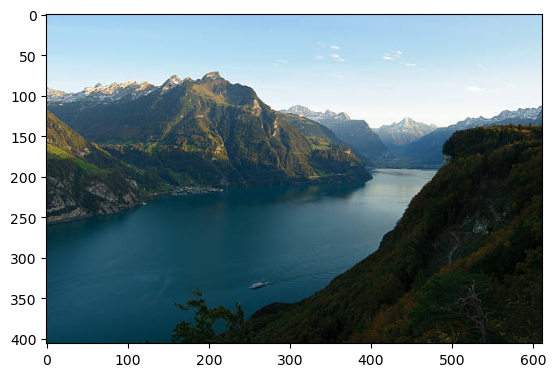

Caption: ferry on the lake at sunset


In [5]:
#Test any index from the whole dataset
data_idx = 11

image_path = "Train_Data(1)/content/Train_Data/Train_Images/"+df.iloc[data_idx,0]
img=mpimg.imread(image_path)
plt.imshow(img)
plt.show()

#showing caption of the image of the given idx
for i in range(data_idx,data_idx+1):
    print("Caption:",df.iloc[i,1])

In [6]:
#using spacy for the better text tokenization
spacy_eng = spacy.load("en_core_web_sm")

#example
text = "This is a good place to find a city"
[token.text.lower() for token in spacy_eng.tokenizer(text)]

['this', 'is', 'a', 'good', 'place', 'to', 'find', 'a', 'city']

In [7]:
class Vocabulary:
    def __init__(self,freq_threshold):
        #setting the pre-reserved tokens int to string tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}

        #string to int tokens
        #its reverse dict self.itos
        self.stoi = {v:k for k,v in self.itos.items()}

        self.freq_threshold = freq_threshold

    def __len__(self): return len(self.itos)

    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]

    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4

        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1

                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1

    def numericalize(self,text):
        """ For each word in the text corresponding index token for that word form the vocab built as list """
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]

In [8]:
class CapsCollate:
    """
    Collate to apply the padding to the captions with dataloader
    """
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first

    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs,dim=0)

        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

In [9]:
#testing the vpcab class
v = Vocabulary(freq_threshold=5)

v.build_vocab(["This is a good place to find a city"])
print(v.stoi)
print(v.numericalize("This is a good place to find a city here!!"))

{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3}
[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]


In [10]:
class Dataset(Dataset):
    def __init__(self,root_dir,captions_file,transform=None,freq_threshold=1): # Freq threshold set to allow more versatility
        self.root_dir = root_dir
        self.df = pd.read_csv(caption_file)
        self.transform = transform

        #Get image and caption colum from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]

        #Initialize vocabulary and build vocab
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())


    def __len__(self):
        return len(self.df)

    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")

        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)

        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]

        return img, torch.tensor(caption_vec)

In [11]:
def get_data_loader(dataset,batch_size,shuffle=False,num_workers=0):
    """
    Returns torch dataloader for the dataset

    """

    pad_idx = dataset.vocab.stoi["<PAD>"]
    collate_fn = CapsCollate(pad_idx=pad_idx,batch_first=True)

    data_loader = DataLoader(
        dataset=dataset,
        batch_size=batch_size,
        shuffle=shuffle,
        num_workers=num_workers,
        collate_fn=collate_fn
    )

    return data_loader

In [12]:
#defing the transform to be applied
transforms = T.Compose([
    T.Resize(226),
    T.RandomCrop(224),
    T.ToTensor(),
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])

In [13]:
def show_image(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


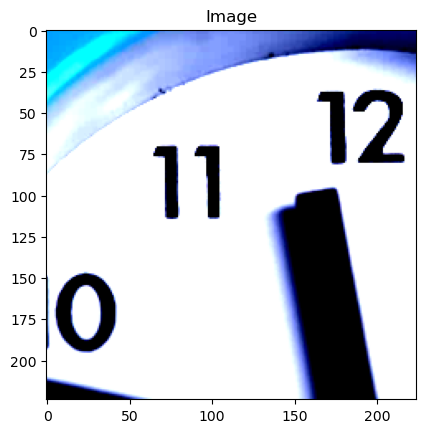

Token: tensor([1, 4, 5, 6, 4, 7, 8, 2])
Sentence:
['<SOS>', 'the', 'arrows', 'on', 'the', 'clock', '.', '<EOS>']


In [14]:
#testing the dataset class
dataset = Dataset(
    root_dir = "Train_Data(1)/content/Train_Data/Train_Images/",
    captions_file = "Train_Data(1)/content/Train_Data/Train_Captioning.csv",
    transform=transforms
)


img, caps = dataset[0]
show_image(img,"Image")
print("Token:",caps)
print("Sentence:")
print([dataset.vocab.itos[token] for token in caps.tolist()])

In [15]:
#writing the dataloader
#setting the hyperparameters
BATCH_SIZE = 256
NUM_WORKER = 0 # Trained on a Windows 11 machine so only 0 would work

#token to represent the padding
pad_idx = dataset.vocab.stoi["<PAD>"]


#writing the dataloader
data_loader = get_data_loader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    # batch_first=False
)

In [16]:
#generating the iterator from the dataloader
dataiter = iter(data_loader)

#getting the next batch
batch = next(dataiter)

#unpacking the batch
images, captions = batch

#showing info of image in single batch
for i in range(BATCH_SIZE):
    img,cap = images[i],captions[i]
    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]
    eos_index = caption_label.index('<EOS>')
    caption_label = caption_label[1:eos_index]
    caption_label = ' '.join(caption_label)
    show_image(img,caption_label)
    plt.show()


"for i in range(BATCH_SIZE):\n    img,cap = images[i],captions[i]\n    caption_label = [dataset.vocab.itos[token] for token in cap.tolist()]\n    eos_index = caption_label.index('<EOS>')\n    caption_label = caption_label[1:eos_index]\n    caption_label = ' '.join(caption_label)\n    show_image(img,caption_label)\n    plt.show()"

In [17]:
#show the tensor image
def show_image(img, title=None):
    """Imshow for Tensor."""

    #unnormalize
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224
    img[2] = img[2] * 0.225
    img[0] += 0.485
    img[1] += 0.456
    img[2] += 0.406

    img = img.numpy().transpose((1, 2, 0))


    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [18]:
# Setup device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [19]:
class EncoderCNN(nn.Module):
    def __init__(self):
        super(EncoderCNN, self).__init__()
        #Resnet 101 gave far better results than resnet50
        resnet = models.resnet101(weights='ResNet101_Weights.IMAGENET1K_V1')#models.resnet50(weights='ResNet50_Weights.IMAGENET1K_V1')#(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)

        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)


    def forward(self, images):
        features = self.resnet(images)                                    #(batch_size,2048,7,7)
        features = features.permute(0, 2, 3, 1)                           #(batch_size,7,7,2048)
        features = features.view(features.size(0), -1, features.size(-1)) #(batch_size,49,2048)
        return features

In [20]:
#Bahdanau Attention
class Attention(nn.Module):
    def __init__(self, encoder_dim,decoder_dim,attention_dim):
        super(Attention, self).__init__()

        self.attention_dim = attention_dim

        self.W = nn.Linear(decoder_dim,attention_dim)
        self.U = nn.Linear(encoder_dim,attention_dim)

        self.A = nn.Linear(attention_dim,1)




    def forward(self, features, hidden_state):
        u_hs = self.U(features)     #(batch_size,num_layers,attention_dim)
        w_ah = self.W(hidden_state) #(batch_size,attention_dim)

        combined_states = torch.tanh(u_hs + w_ah.unsqueeze(1)) #(batch_size,num_layers,attemtion_dim)

        attention_scores = self.A(combined_states)         #(batch_size,num_layers,1)
        attention_scores = attention_scores.squeeze(2)     #(batch_size,num_layers)


        alpha = F.softmax(attention_scores,dim=1)          #(batch_size,num_layers)

        attention_weights = features * alpha.unsqueeze(2)  #(batch_size,num_layers,features_dim)
        attention_weights = attention_weights.sum(dim=1)   #(batch_size,num_layers)

        return alpha,attention_weights

In [21]:
#Attention Decoder
class DecoderRNN(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()

        #save the model param
        self.vocab_size = vocab_size
        self.attention_dim = attention_dim
        self.decoder_dim = decoder_dim

        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.attention = Attention(encoder_dim,decoder_dim,attention_dim)


        self.init_h = nn.Linear(encoder_dim, decoder_dim)
        self.init_c = nn.Linear(encoder_dim, decoder_dim)
        self.lstm_cell = nn.LSTMCell(embed_size+encoder_dim,decoder_dim,bias=True)
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)


        self.fcn = nn.Linear(decoder_dim,vocab_size)
        self.drop = nn.Dropout(drop_prob)



    def forward(self, features, captions):

        #vectorize the caption
        embeds = self.embedding(captions)

        # Initialize LSTM state
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)

        #get the seq length to iterate
        seq_length = len(captions[0])-1 #Exclude the last one
        batch_size = captions.size(0)
        num_features = features.size(1)

        preds = torch.zeros(batch_size, seq_length, self.vocab_size).to(device)
        alphas = torch.zeros(batch_size, seq_length,num_features).to(device)

        for s in range(seq_length):
            alpha,context = self.attention(features, h)
            lstm_input = torch.cat((embeds[:, s], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))

            output = self.fcn(self.drop(h))

            preds[:,s] = output
            alphas[:,s] = alpha


        return preds, alphas

    def generate_caption(self,features,max_len=20,vocab=None):
        # Inference part
        # Given the image features generate the captions

        batch_size = features.size(0)
        h, c = self.init_hidden_state(features)  # (batch_size, decoder_dim)

        alphas = []

        #starting input
        word = torch.tensor(vocab.stoi['<SOS>']).view(1,-1).to(device)
        embeds = self.embedding(word)


        captions = []

        for i in range(max_len):
            alpha,context = self.attention(features, h)


            #store the apla score
            alphas.append(alpha.cpu().detach().numpy())

            lstm_input = torch.cat((embeds[:, 0], context), dim=1)
            h, c = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))
            output = output.view(batch_size,-1)


            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)

            #save the generated word
            captions.append(predicted_word_idx.item())

            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break

            #send generated word as the next caption
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))

        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions],alphas


    def init_hidden_state(self, encoder_out):
        mean_encoder_out = encoder_out.mean(dim=1)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c

In [22]:
class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, vocab_size, attention_dim,encoder_dim,decoder_dim,drop_prob=0.3):
        super().__init__()
        self.encoder = EncoderCNN()
        self.decoder = DecoderRNN(
            embed_size=embed_size,
            vocab_size = len(dataset.vocab),
            attention_dim=attention_dim,
            encoder_dim=encoder_dim,
            decoder_dim=decoder_dim
        )

    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

In [23]:
#Hyperparameters
embed_size=300
vocab_size = len(dataset.vocab)
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 3e-4

In [24]:
#init model
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

In [24]:
#helper function to save the model
def save_model(model,num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }

    torch.save(model.state_dict(),'model_dict.pkl') #attention_model_state.pkl

  0%|          | 0/80 [00:00<?, ?it/s]

0it [00:00, ?it/s]

Epoch: 1 loss: 5.18947
Perplexity: 179.37376861911827


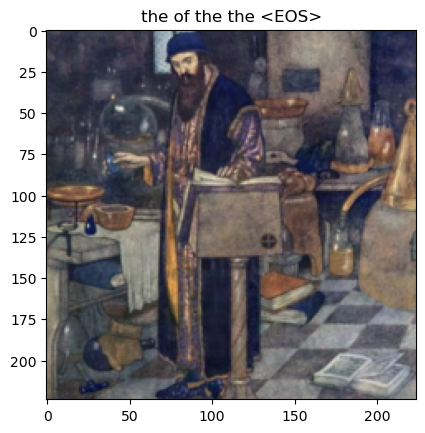

0it [00:00, ?it/s]

Epoch: 2 loss: 5.01376
Perplexity: 150.469452456237


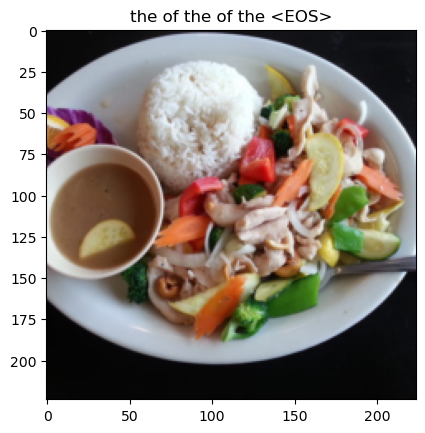

0it [00:00, ?it/s]

Epoch: 3 loss: 4.81887
Perplexity: 123.82492057999039


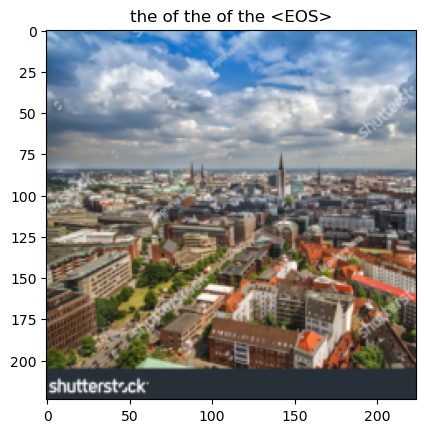

0it [00:00, ?it/s]

Epoch: 4 loss: 4.63493
Perplexity: 103.02072007957072


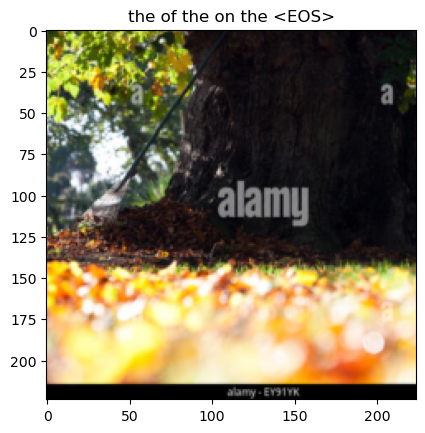

0it [00:00, ?it/s]

Epoch: 5 loss: 4.50528
Perplexity: 90.49393925232356


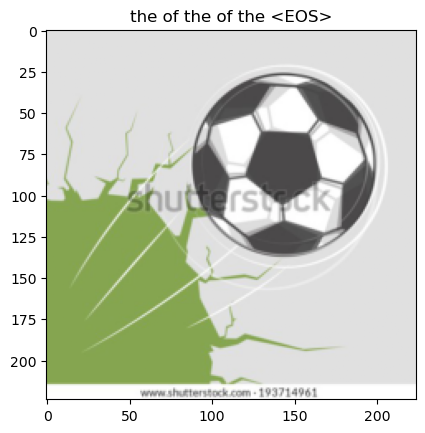

0it [00:00, ?it/s]

Epoch: 6 loss: 4.29046
Perplexity: 72.99970071453608


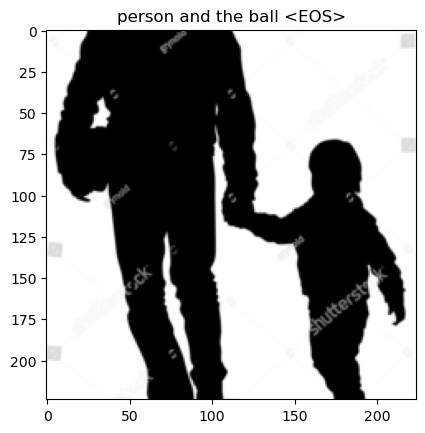

0it [00:00, ?it/s]

Epoch: 7 loss: 4.35588
Perplexity: 77.93502697758937


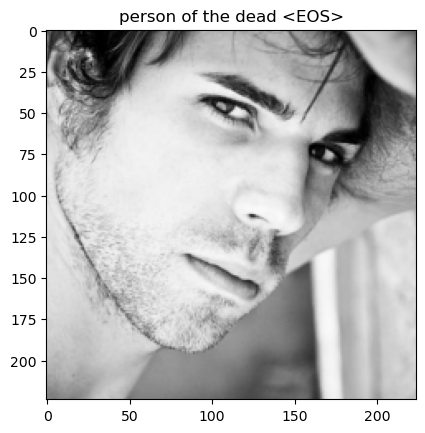

0it [00:00, ?it/s]

Epoch: 8 loss: 4.12104
Perplexity: 61.62358285142692


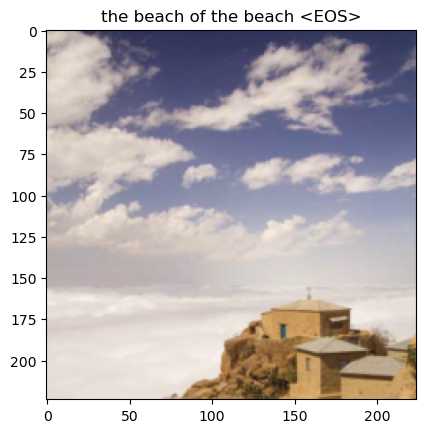

0it [00:00, ?it/s]

Epoch: 9 loss: 4.06488
Perplexity: 58.25768875675956


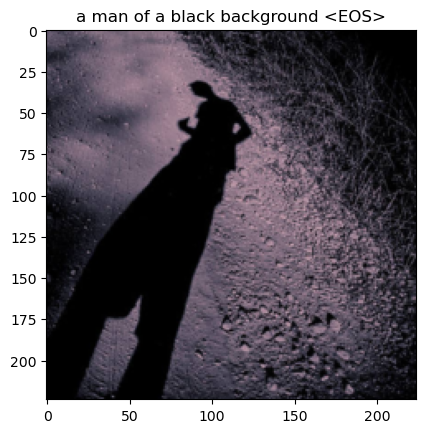

0it [00:00, ?it/s]

Epoch: 10 loss: 3.95432
Perplexity: 52.15999912288865


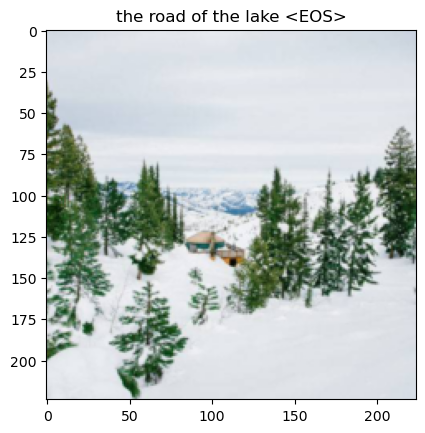

0it [00:00, ?it/s]

Epoch: 11 loss: 3.69693
Perplexity: 40.323193810625554


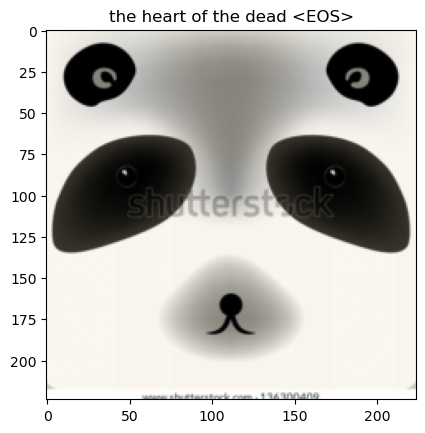

0it [00:00, ?it/s]

Epoch: 12 loss: 3.84350
Perplexity: 46.68860531331759


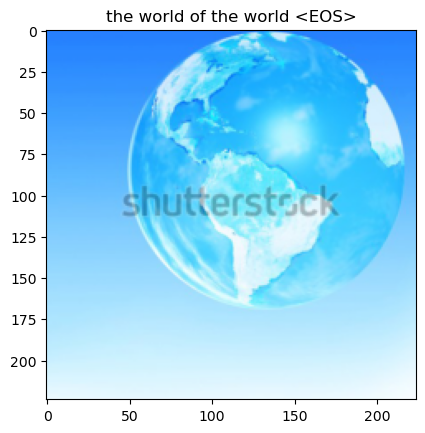

0it [00:00, ?it/s]

Epoch: 13 loss: 3.74246
Perplexity: 42.20183015546964


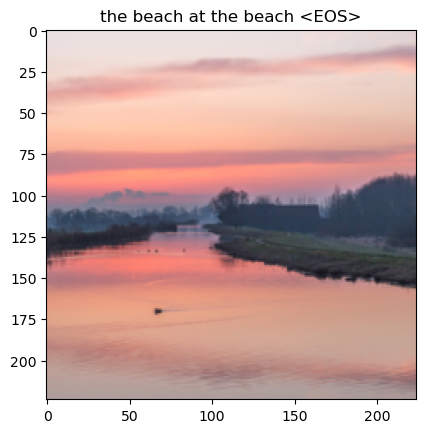

0it [00:00, ?it/s]

Epoch: 14 loss: 3.70250
Perplexity: 40.548737061360555


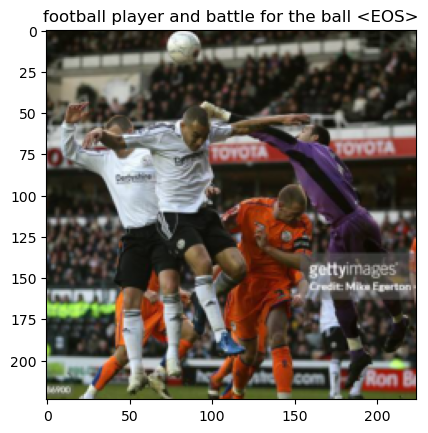

0it [00:00, ?it/s]

Epoch: 15 loss: 3.57499
Perplexity: 35.69426508852799


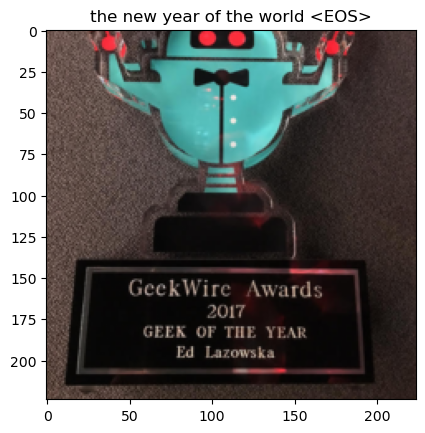

0it [00:00, ?it/s]

Epoch: 16 loss: 3.54712
Perplexity: 34.713326790264944


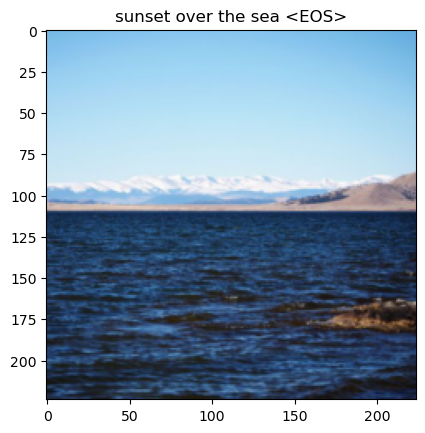

0it [00:00, ?it/s]

Epoch: 17 loss: 3.40839
Perplexity: 30.216557785131336


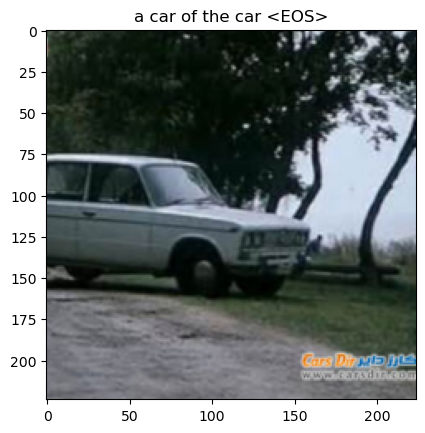

0it [00:00, ?it/s]

Epoch: 18 loss: 3.39791
Perplexity: 29.901444200280793


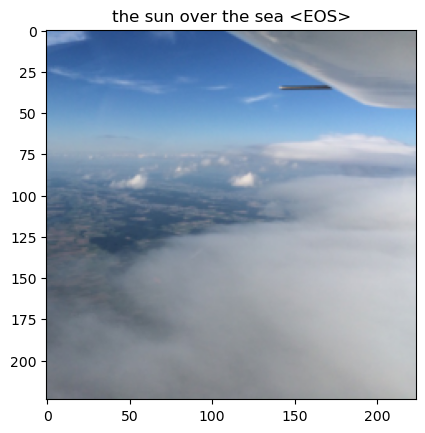

0it [00:00, ?it/s]

Epoch: 19 loss: 3.28278
Perplexity: 26.649805156136267


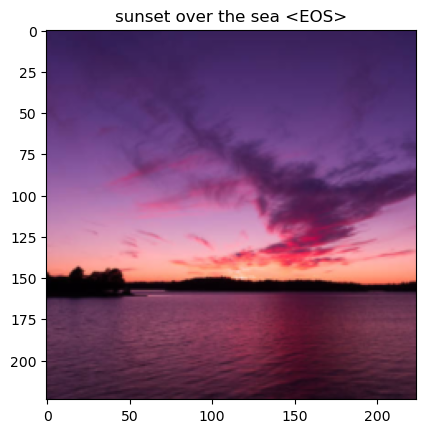

0it [00:00, ?it/s]

Epoch: 20 loss: 3.11349
Perplexity: 22.49953482671188


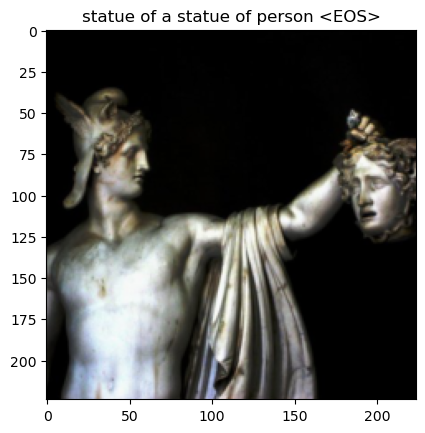

0it [00:00, ?it/s]

Epoch: 21 loss: 3.13342
Perplexity: 22.952282064739578


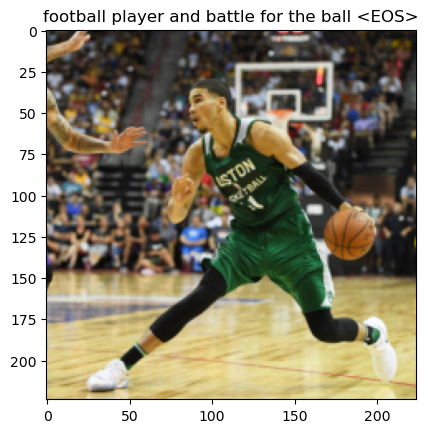

0it [00:00, ?it/s]

Epoch: 22 loss: 3.05948
Perplexity: 21.316438195651024


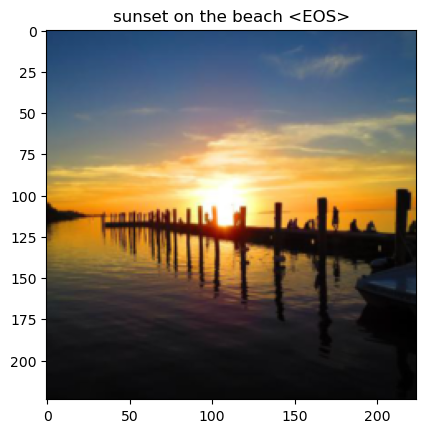

0it [00:00, ?it/s]

Epoch: 23 loss: 2.94718
Perplexity: 19.052160544805403


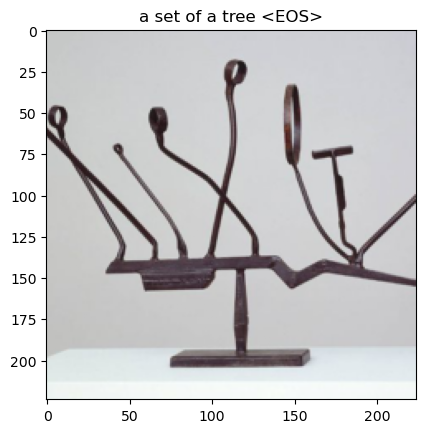

0it [00:00, ?it/s]

Epoch: 24 loss: 3.17628
Perplexity: 23.95738635958346


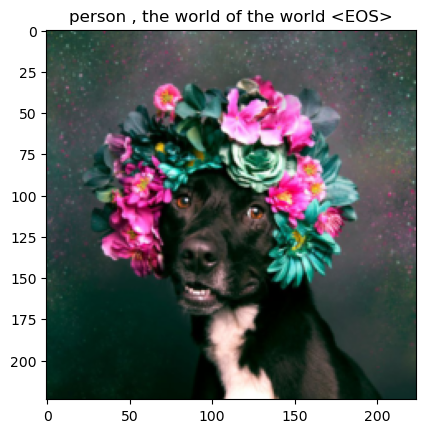

0it [00:00, ?it/s]

Epoch: 25 loss: 3.16035
Perplexity: 23.57886593423415


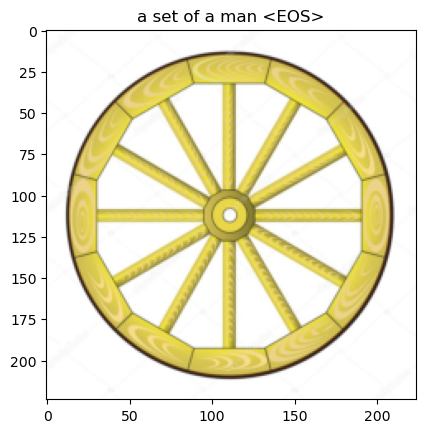

0it [00:00, ?it/s]

Epoch: 26 loss: 2.87942
Perplexity: 17.803982848552778


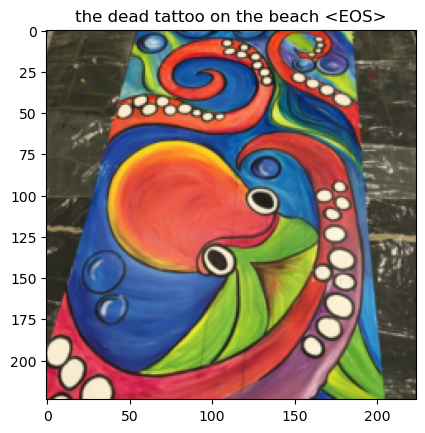

0it [00:00, ?it/s]

Epoch: 27 loss: 2.80311
Perplexity: 16.49594598161155


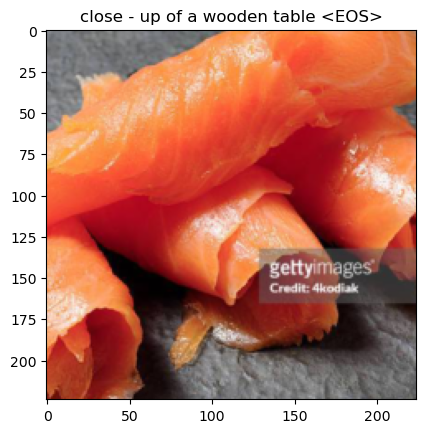

0it [00:00, ?it/s]

Epoch: 28 loss: 2.76314
Perplexity: 15.849607419355218


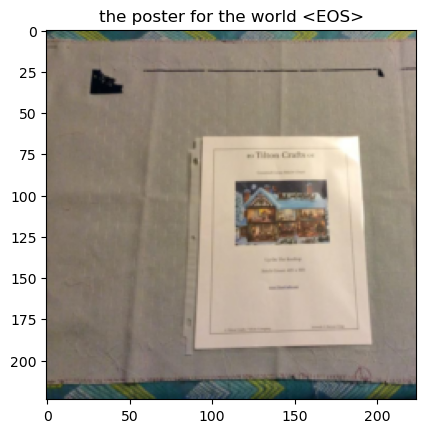

0it [00:00, ?it/s]

Epoch: 29 loss: 2.64856
Perplexity: 14.133645206175535


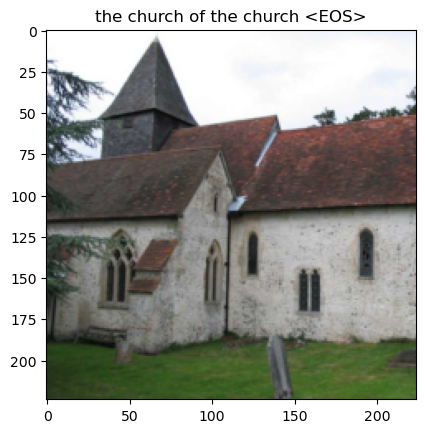

0it [00:00, ?it/s]

Epoch: 30 loss: 2.67501
Perplexity: 14.512484088748392


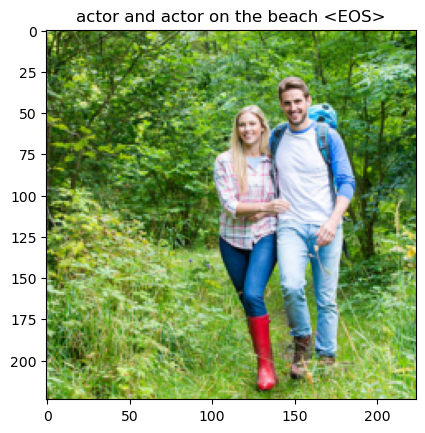

0it [00:00, ?it/s]

Epoch: 31 loss: 2.71293
Perplexity: 15.073429232634844


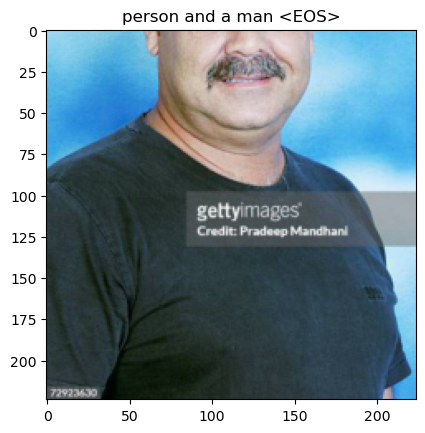

0it [00:00, ?it/s]

Epoch: 32 loss: 2.48976
Perplexity: 12.058329072446352


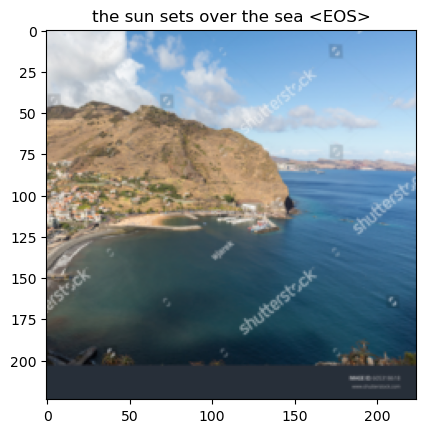

0it [00:00, ?it/s]

Epoch: 33 loss: 2.47278
Perplexity: 11.855316455031858


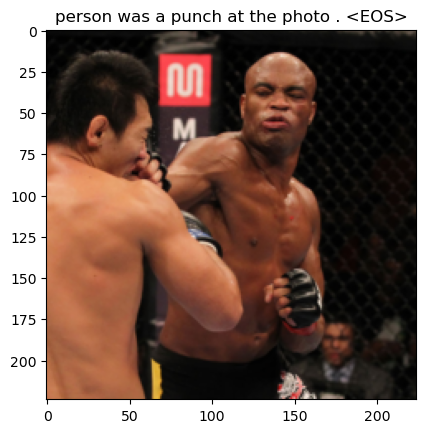

0it [00:00, ?it/s]

Epoch: 34 loss: 2.40594
Perplexity: 11.088809865171667


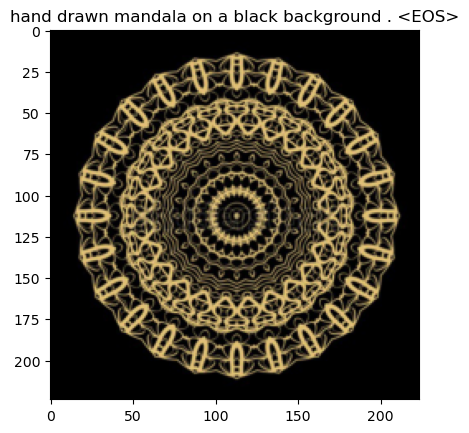

0it [00:00, ?it/s]

Epoch: 35 loss: 2.42652
Perplexity: 11.319371830427947


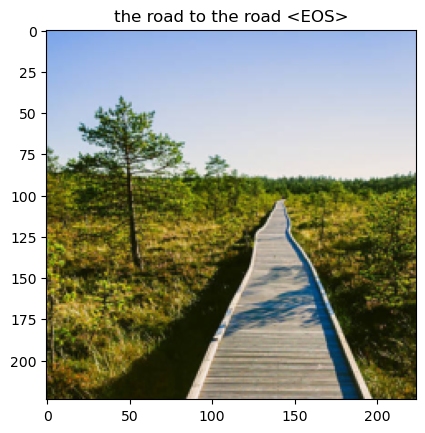

0it [00:00, ?it/s]

Epoch: 36 loss: 2.37915
Perplexity: 10.795760276518225


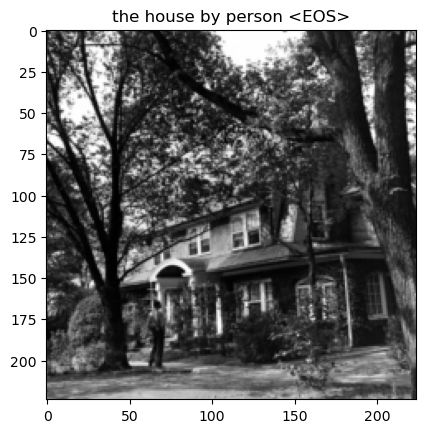

0it [00:00, ?it/s]

Epoch: 37 loss: 2.28695
Perplexity: 9.844884879609875


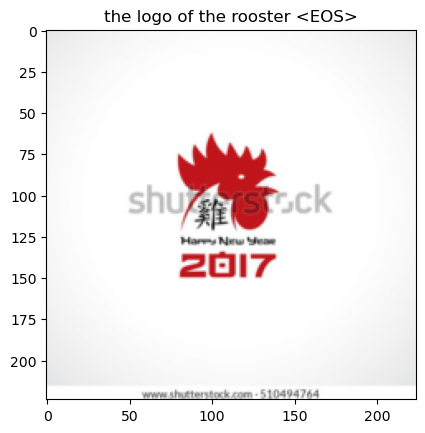

0it [00:00, ?it/s]

Epoch: 38 loss: 2.30343
Perplexity: 10.00847014864486


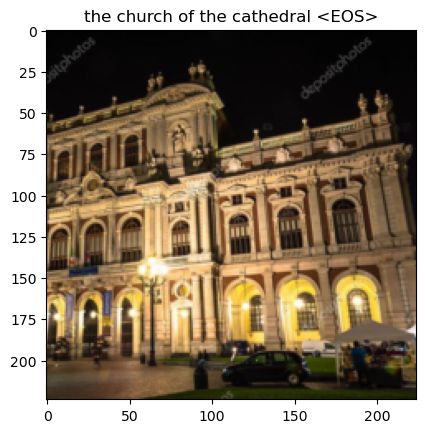

0it [00:00, ?it/s]

Epoch: 39 loss: 2.07008
Perplexity: 7.925465019328615


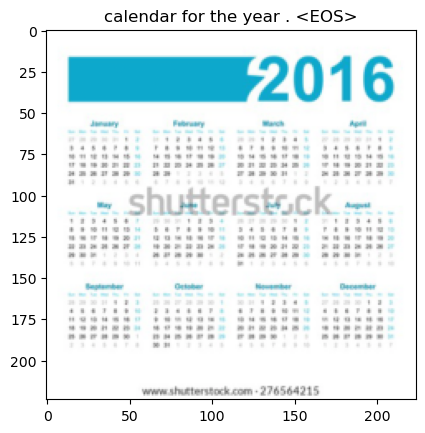

0it [00:00, ?it/s]

Epoch: 40 loss: 2.26181
Perplexity: 9.60049437236102


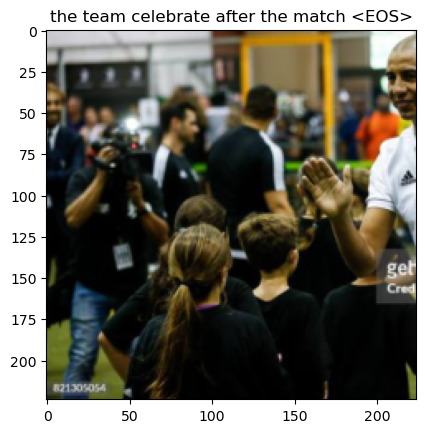

0it [00:00, ?it/s]

Epoch: 41 loss: 2.02868
Perplexity: 7.604032172578426


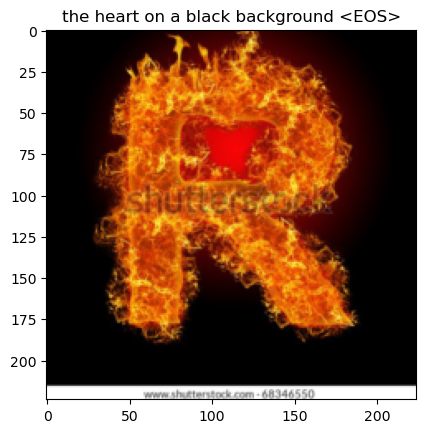

0it [00:00, ?it/s]

Epoch: 42 loss: 2.10936
Perplexity: 8.242993410359773


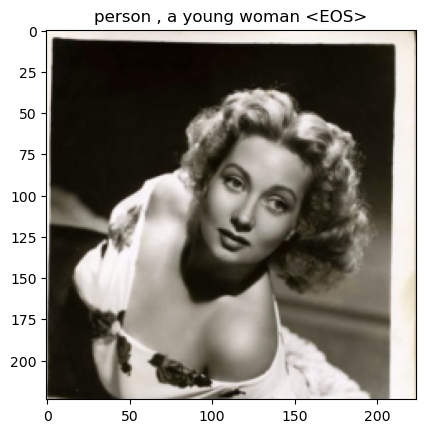

0it [00:00, ?it/s]

Epoch: 43 loss: 2.10510
Perplexity: 8.207903506038138


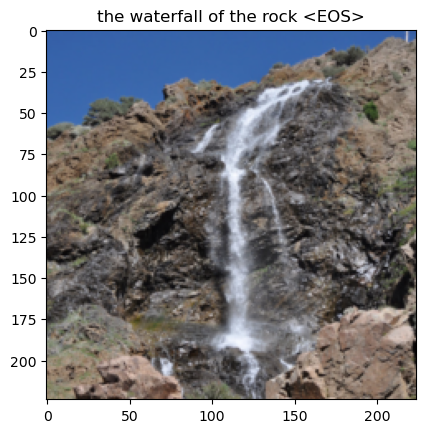

0it [00:00, ?it/s]

Epoch: 44 loss: 1.91632
Perplexity: 6.795925116357954


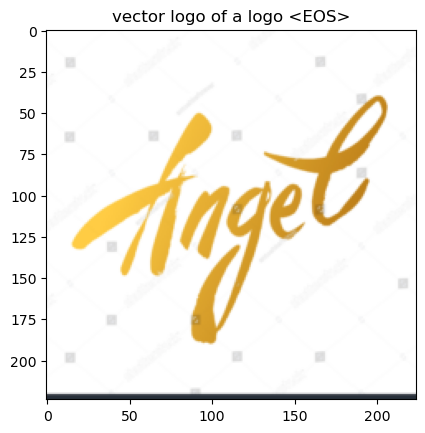

0it [00:00, ?it/s]

Epoch: 45 loss: 1.93058
Perplexity: 6.893490196941502


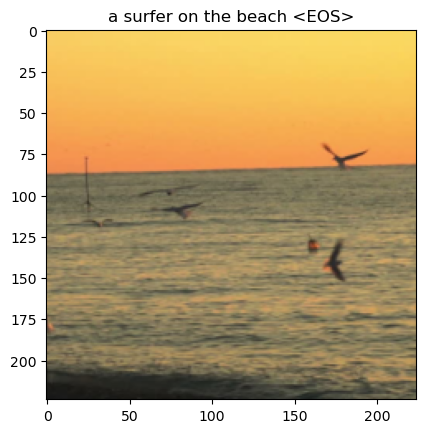

0it [00:00, ?it/s]

Epoch: 46 loss: 1.76592
Perplexity: 5.846959784106562


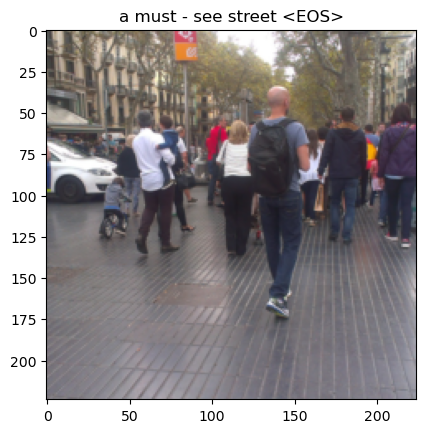

0it [00:00, ?it/s]

Epoch: 47 loss: 1.79632
Perplexity: 6.027436221033355


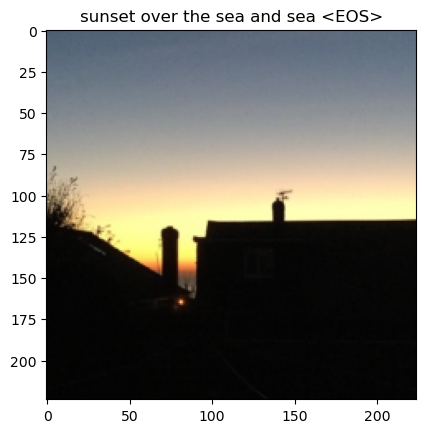

0it [00:00, ?it/s]

Epoch: 48 loss: 1.77567
Perplexity: 5.904261995932544


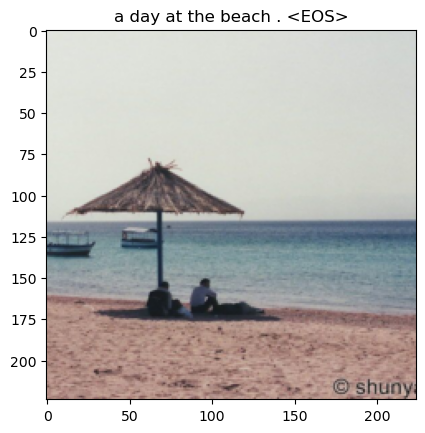

0it [00:00, ?it/s]

Epoch: 49 loss: 1.76489
Perplexity: 5.840919812571197


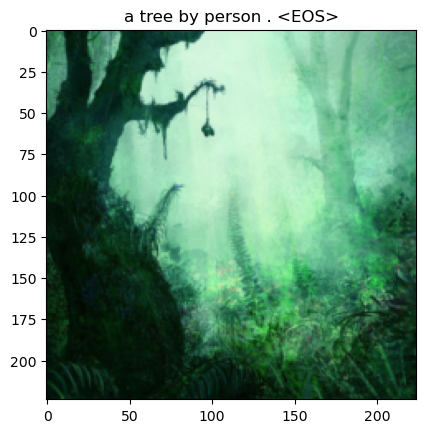

0it [00:00, ?it/s]

Epoch: 50 loss: 1.75198
Perplexity: 5.7659995235119865


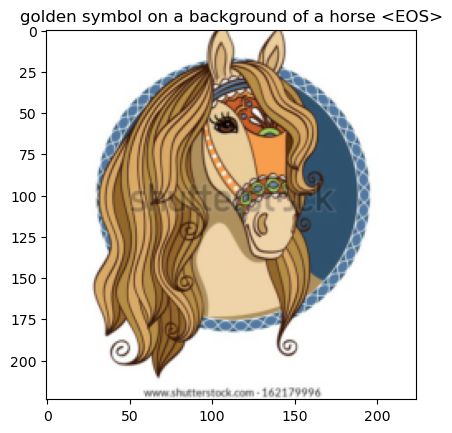

0it [00:00, ?it/s]

Epoch: 51 loss: 1.74987
Perplexity: 5.753851552734588


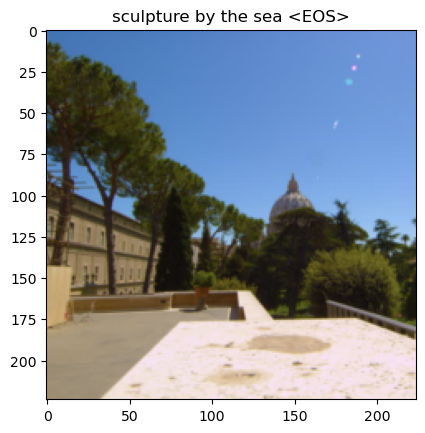

0it [00:00, ?it/s]

Epoch: 52 loss: 1.50781
Perplexity: 4.516813547877422


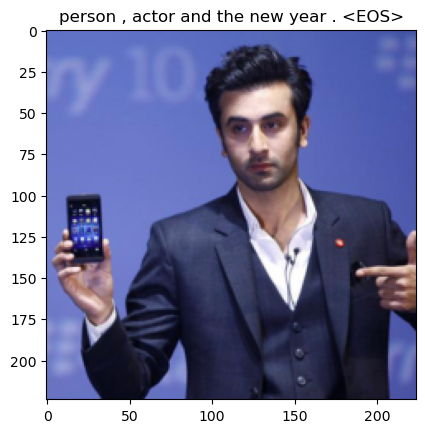

0it [00:00, ?it/s]

Epoch: 53 loss: 1.70643
Perplexity: 5.509235717177331


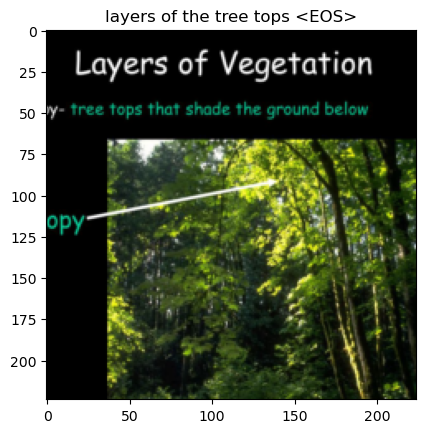

0it [00:00, ?it/s]

Epoch: 54 loss: 1.49710
Perplexity: 4.468700858214811


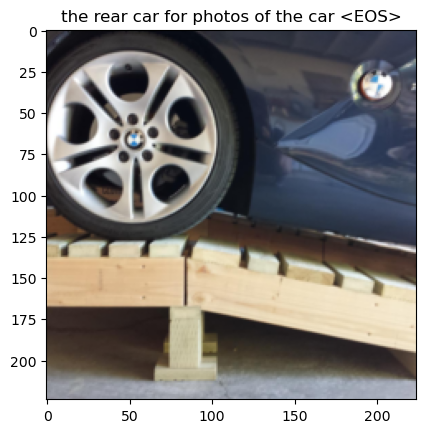

0it [00:00, ?it/s]

Epoch: 55 loss: 1.54377
Perplexity: 4.682197037553845


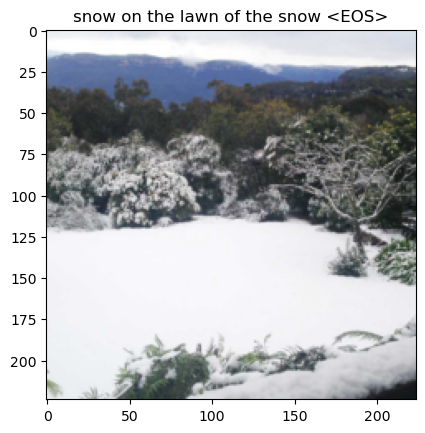

0it [00:00, ?it/s]

Epoch: 56 loss: 1.52366
Perplexity: 4.588976816883292


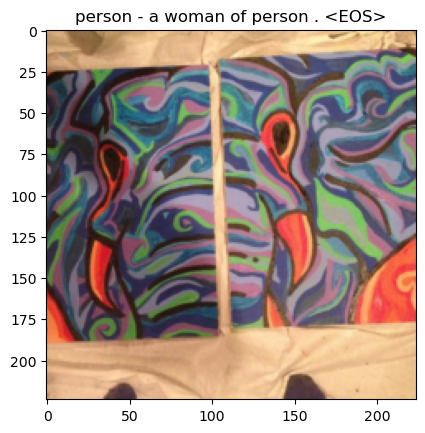

0it [00:00, ?it/s]

Epoch: 57 loss: 1.40591
Perplexity: 4.079221659182298


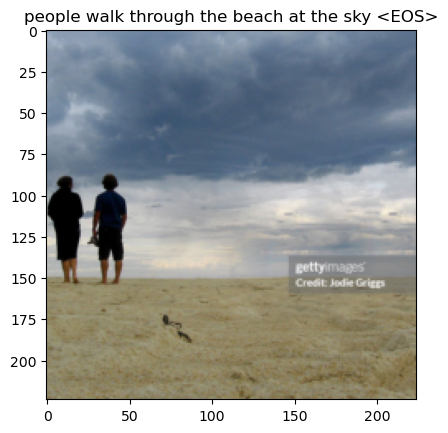

0it [00:00, ?it/s]

Epoch: 58 loss: 1.47584
Perplexity: 4.3746968705703875


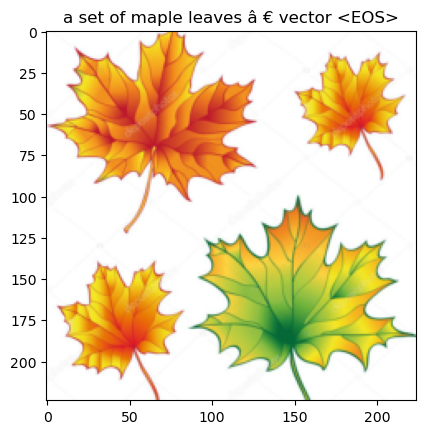

0it [00:00, ?it/s]

Epoch: 59 loss: 1.33842
Perplexity: 3.8130320359759127


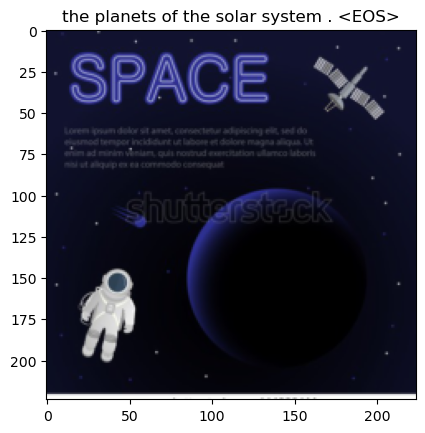

0it [00:00, ?it/s]

Epoch: 60 loss: 1.43316
Perplexity: 4.191936039749448


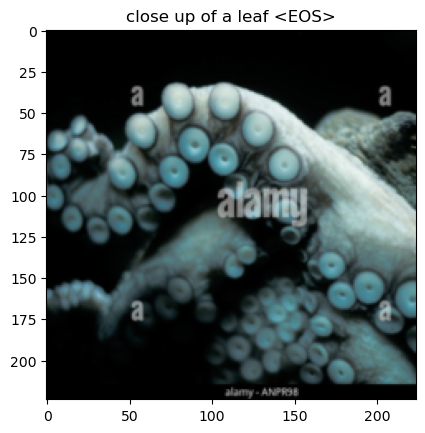

0it [00:00, ?it/s]

Epoch: 61 loss: 1.27452
Perplexity: 3.5769701156311213


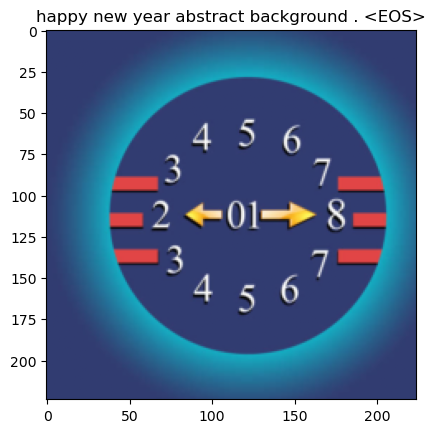

0it [00:00, ?it/s]

Epoch: 62 loss: 1.25771
Perplexity: 3.517351568411492


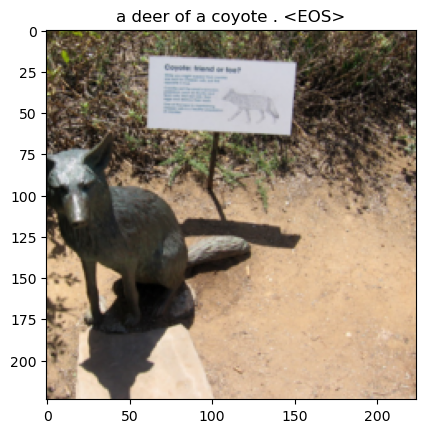

0it [00:00, ?it/s]

Epoch: 63 loss: 1.26643
Perplexity: 3.5481706687667516


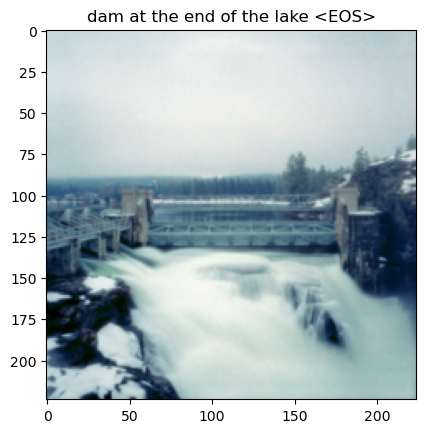

0it [00:00, ?it/s]

Epoch: 64 loss: 1.31472
Perplexity: 3.7236981201093062


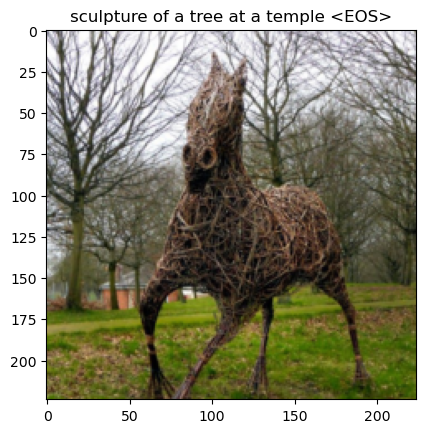

0it [00:00, ?it/s]

Epoch: 65 loss: 1.24168
Perplexity: 3.461424690130338


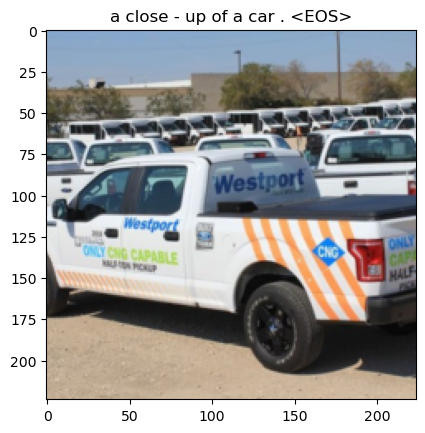

0it [00:00, ?it/s]

Epoch: 66 loss: 1.15741
Perplexity: 3.181672638198558


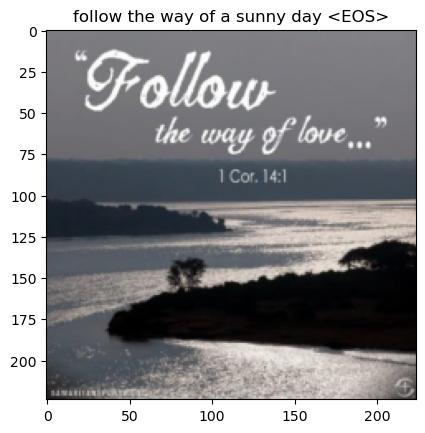

0it [00:00, ?it/s]

Epoch: 67 loss: 1.15273
Perplexity: 3.1668374661650076


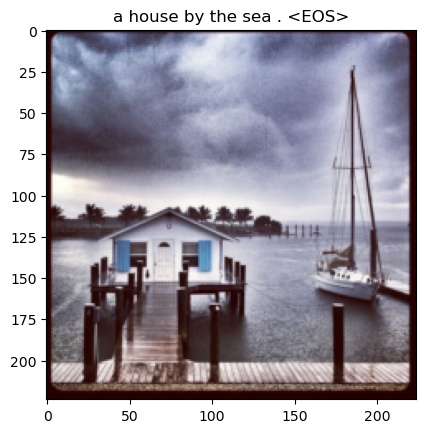

0it [00:00, ?it/s]

Epoch: 68 loss: 1.12557
Perplexity: 3.0819695802917697


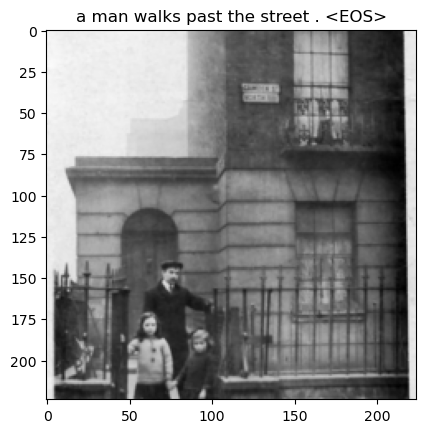

0it [00:00, ?it/s]

Epoch: 69 loss: 1.11932
Perplexity: 3.062755583393653


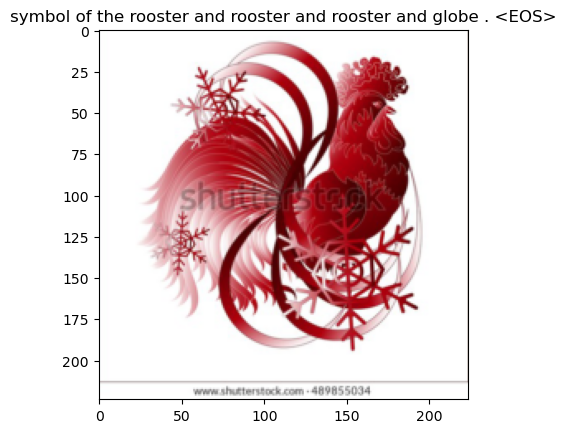

0it [00:00, ?it/s]

Epoch: 70 loss: 1.05572
Perplexity: 2.8740580289166484


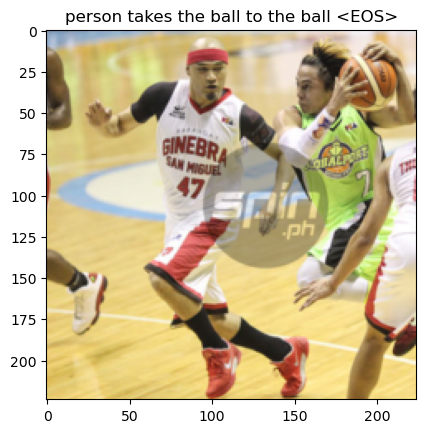

0it [00:00, ?it/s]

Epoch: 71 loss: 1.06913
Perplexity: 2.912841975826788


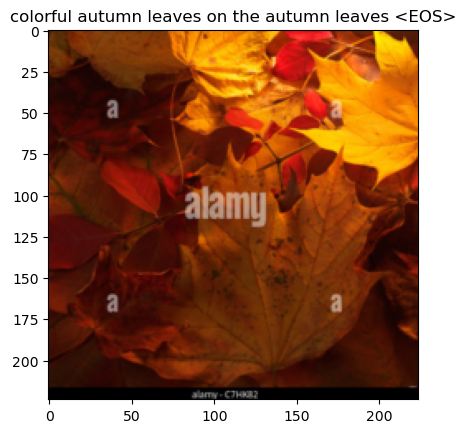

0it [00:00, ?it/s]

Epoch: 72 loss: 1.02537
Perplexity: 2.788128543538949


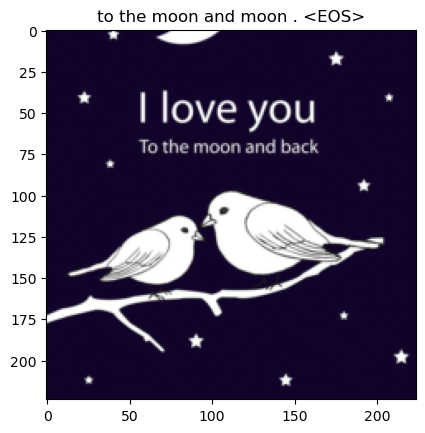

0it [00:00, ?it/s]

Epoch: 73 loss: 0.93532
Perplexity: 2.5480220642663456


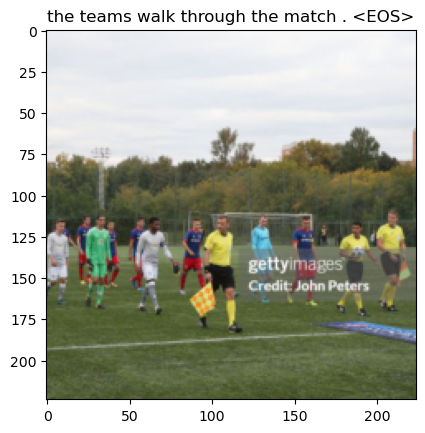

0it [00:00, ?it/s]

Epoch: 74 loss: 1.02742
Perplexity: 2.7938458576969136


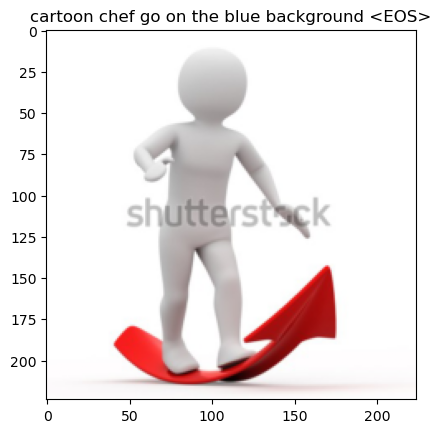

0it [00:00, ?it/s]

Epoch: 75 loss: 0.97622
Perplexity: 2.6543992098569698


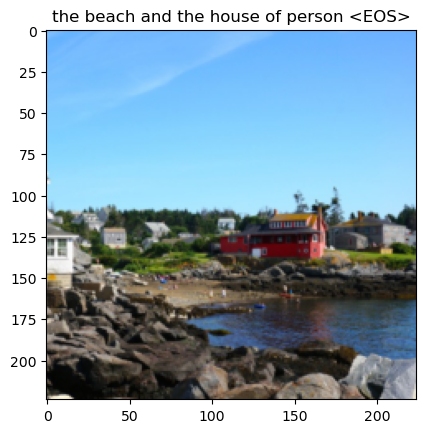

0it [00:00, ?it/s]

Epoch: 76 loss: 0.96221
Perplexity: 2.6174868731684575


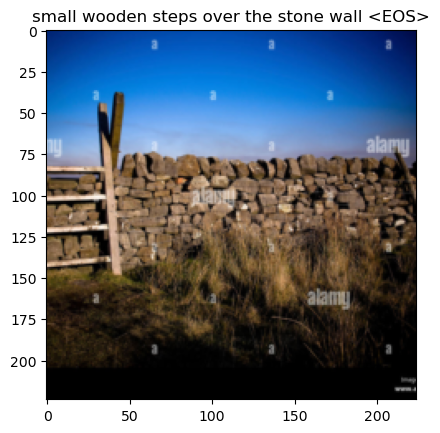

0it [00:00, ?it/s]

Epoch: 77 loss: 0.87815
Perplexity: 2.4064374643155464


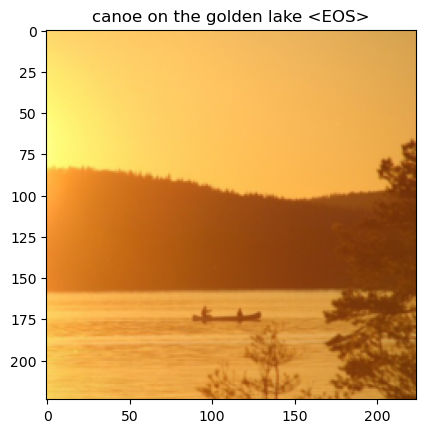

0it [00:00, ?it/s]

Epoch: 78 loss: 0.89600
Perplexity: 2.449794200341298


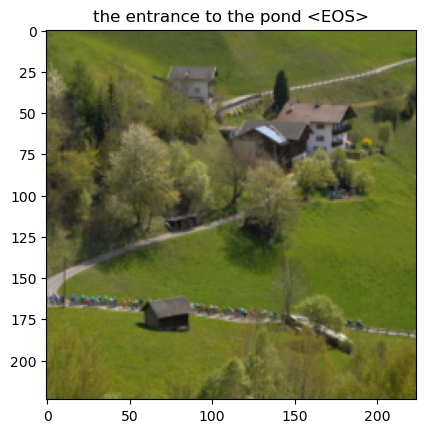

0it [00:00, ?it/s]

Epoch: 79 loss: 0.87994
Perplexity: 2.4107455088719836


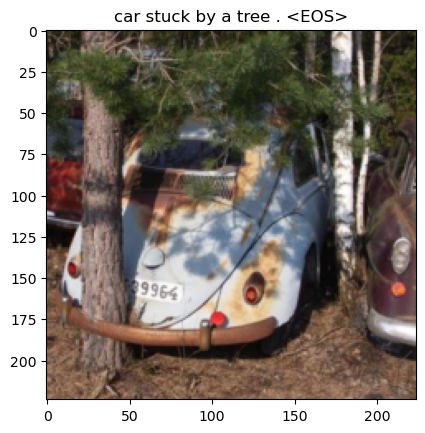

0it [00:00, ?it/s]

Epoch: 80 loss: 0.88078
Perplexity: 2.4127921148472513


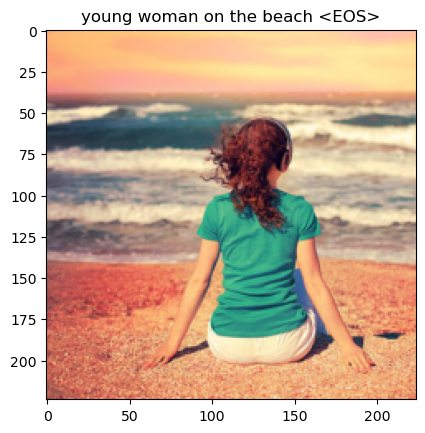

In [25]:
num_epochs = 80 #250
print_every = 30 #100

for epoch in tqdm(range(1,num_epochs+1)):
    for idx, (image, captions) in tqdm(enumerate(iter(data_loader))):
    #for batch in tqdm(data_loader):
        image,captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Forward pass
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))

        # Backward pass.
        loss.backward()
        
        # Record the perplexity
        perplexity_val = np.exp(loss.item())
        
        # Update the parameters in the optimizer.
        optimizer.step()

        if (idx+1)%print_every == 0: #idx+1
            print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
            print("Perplexity:", perplexity_val)
            
            references = list()  # references (true captions) for calculating BLEU-4 score
            hypotheses = list()  # hypotheses (predictions)

            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0],title=caption)

            model.train()

    #save the latest model
    save_model(model,epoch)

In [26]:
#torch.save(model.state_dict(), "model_dict.pkl")

In [27]:
#torch.save(model, "model.pkl")

In [25]:
# Model class must be defined somewhere
#trained_model = torch.load("model.pkl")
model.load_state_dict(torch.load("model_dict.pkl"))
model.eval()

EncoderDecoder(
  (encoder): EncoderCNN(
    (resnet): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
 

In [29]:
# a function to determine whether a string is a URL or not
def is_url(string):
    try:
        result = parse.urlparse(string)
        return all([result.scheme, result.netloc, result.path])
    except:
        return False

# a function to load an image
def load_image(image_path):
    if is_url(image_path):
        return Image.open(requests.get(image_path, stream=True).raw)
    elif os.path.exists(image_path):
        return Image.open(image_path)

#generate caption
def get_caps_from(features_tensors):
    #generate the caption
    model.eval()
    with torch.no_grad():
        features = model.encoder(features_tensors.to(device))
        caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
        caption = ' '.join(caps)
        show_image(features_tensors[0],title=caption)

    return caps,alphas

# a function to perform inference
def get_caption(model, image_path):
    image = load_image(image_path)
    convert_tensor = transforms.ToTensor()
    image = load_image(image_path)
    img = convert_tensor(image)
    caps,alphas = get_caps_from(img.unsqueeze(0))
    return caps

In [33]:
def show_image_and_captions(url):
  # get the image and display it
  display(load_image(url))
  # get the captions on various models
  our_caption = get_caption(model, url)

  # print the captions
  print(f"Caption: {our_caption}")

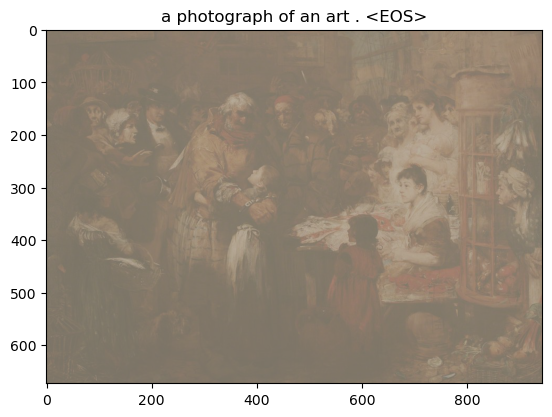

In [36]:
image_path = "https://d3d00swyhr67nd.cloudfront.net/w944h944/collection/CW/ELT/CW_ELT_01-001.jpg"
convert_tensor = transforms.ToTensor()
image = load_image(image_path)
img = convert_tensor(image)
caps,alphas = get_caps_from(img.unsqueeze(0))

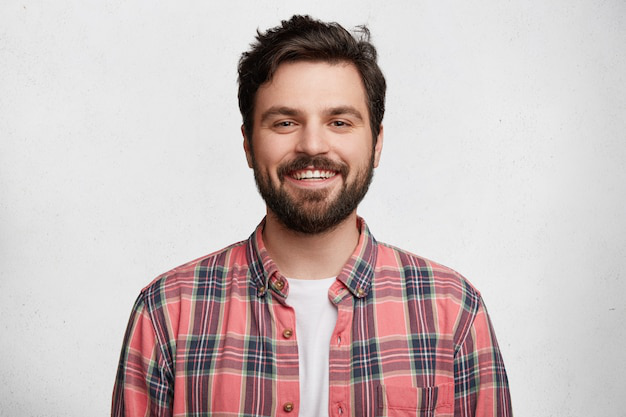

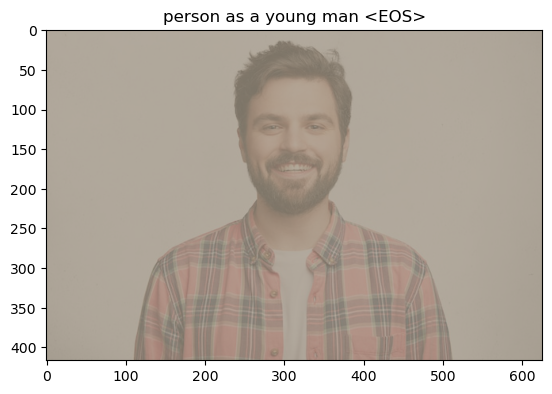

Caption: ['person', 'as', 'a', 'young', 'man', '<EOS>']


In [37]:
# Generic image to test functionality
show_image_and_captions("https://img.freepik.com/free-photo/young-bearded-man-with-striped-shirt_273609-5677.jpg")

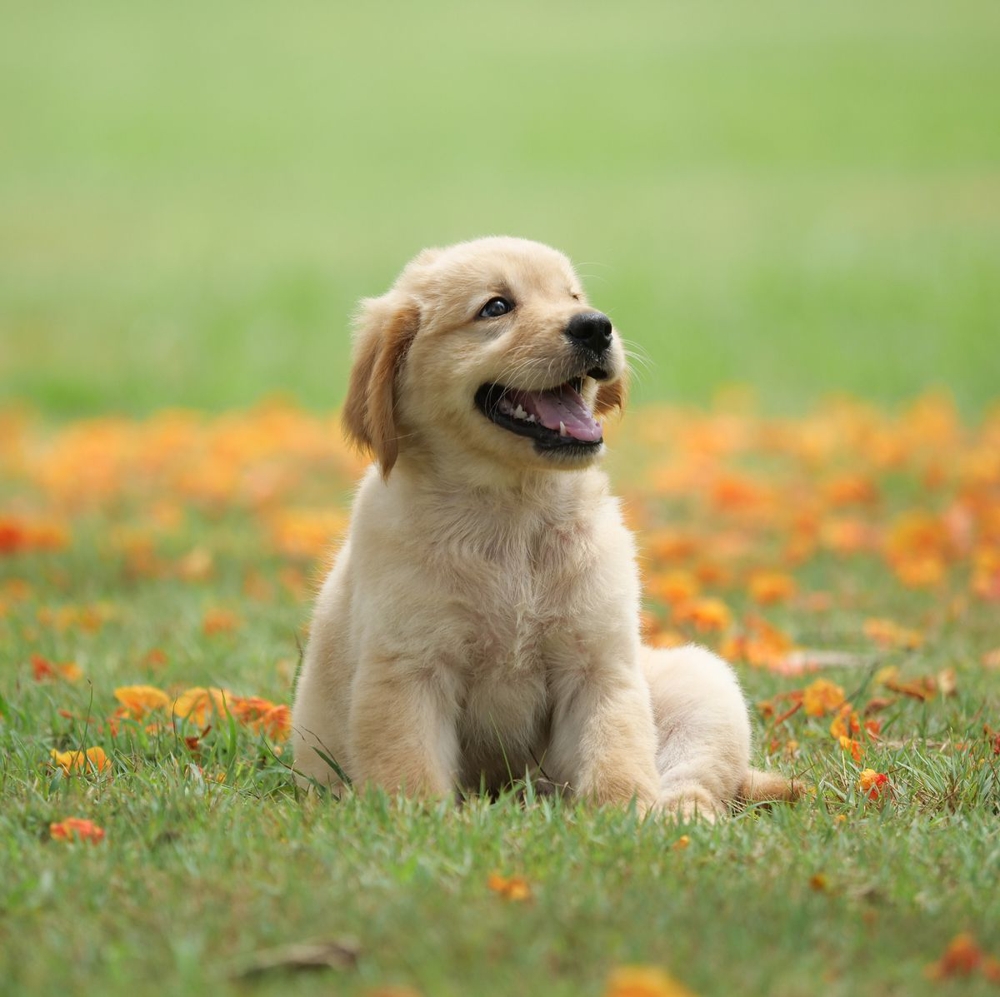

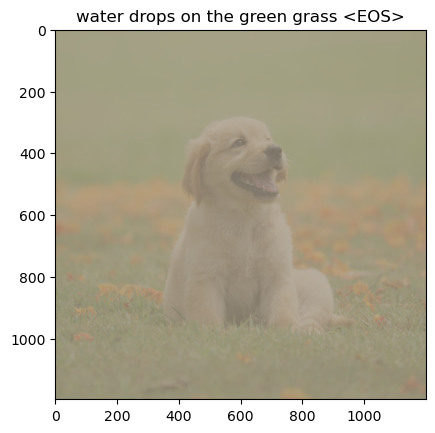

Caption: ['water', 'drops', 'on', 'the', 'green', 'grass', '<EOS>']


In [38]:
# Generic image to test functionality
show_image_and_captions("https://hips.hearstapps.com/hmg-prod/images/dog-puppy-on-garden-royalty-free-image-1586966191.jpg?crop=0.752xw:1.00xh;0.175xw,0&resize=1200:*")

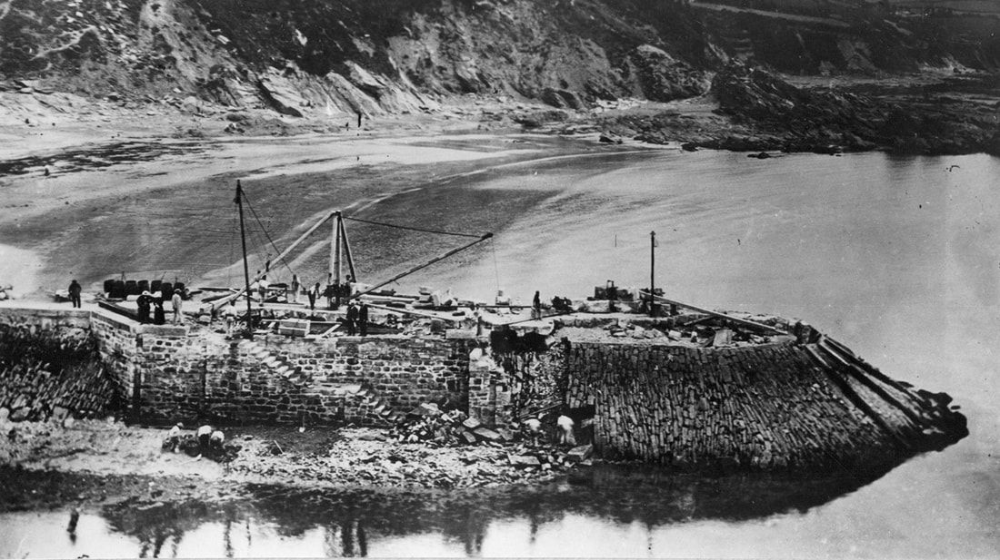

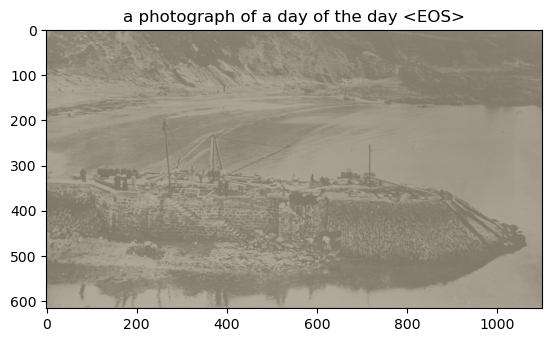

Caption: ['a', 'photograph', 'of', 'a', 'day', 'of', 'the', 'day', '<EOS>']


In [39]:
# Actual Looe art museum images
show_image_and_captions("https://www.looemuseum.co.uk/uploads/1/3/2/7/132730441/published/new-pier.jpg?1600447157")

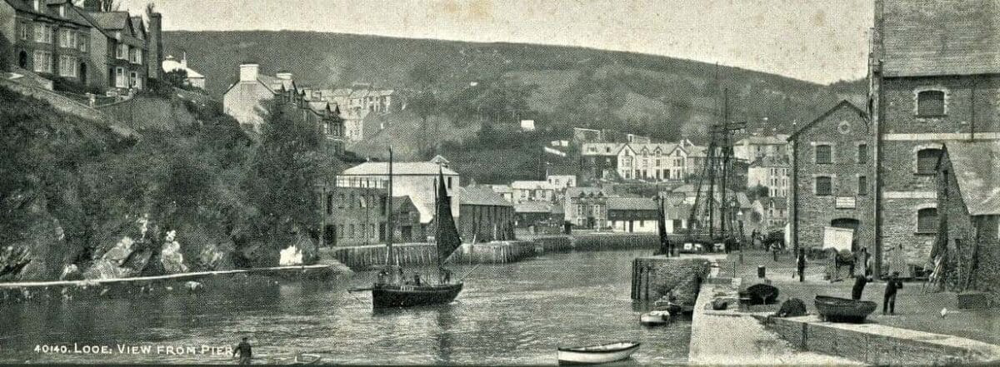

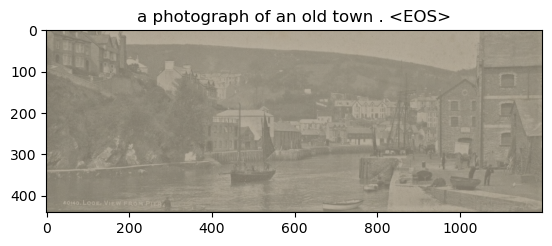

Caption: ['a', 'photograph', 'of', 'an', 'old', 'town', '.', '<EOS>']


In [40]:
show_image_and_captions("https://www.parishmouse.co.uk/cornwall/wp-content/uploads/2021/06/c1908-panoramic-looe-view-from-pier-1200x441.jpg")

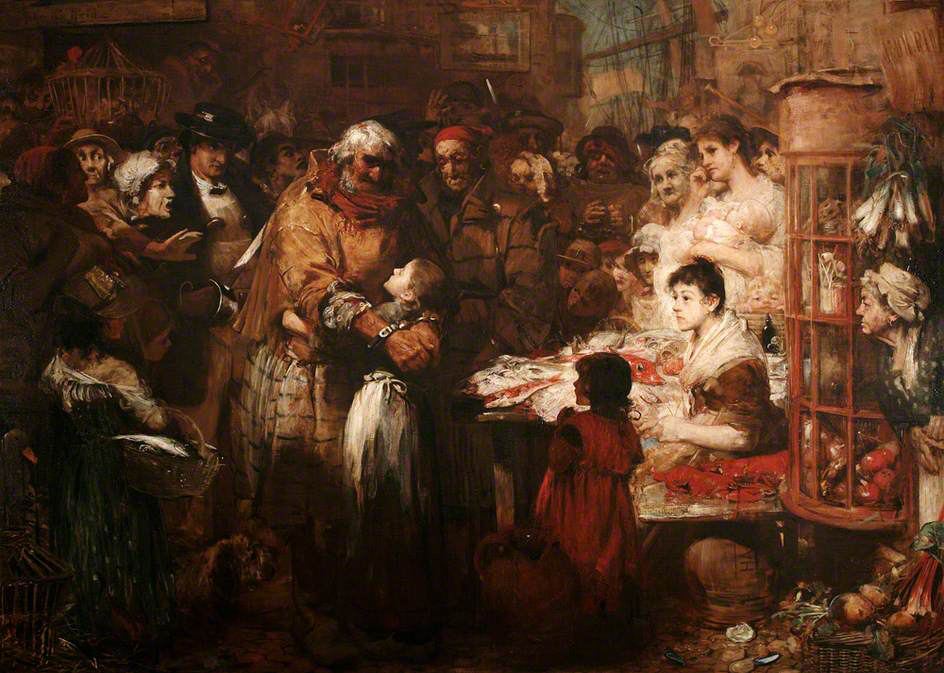

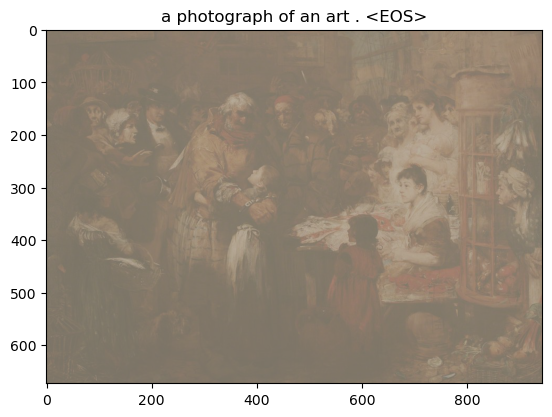

Caption: ['a', 'photograph', 'of', 'an', 'art', '.', '<EOS>']


In [41]:
show_image_and_captions("https://d3d00swyhr67nd.cloudfront.net/w944h944/collection/CW/ELT/CW_ELT_01-001.jpg")

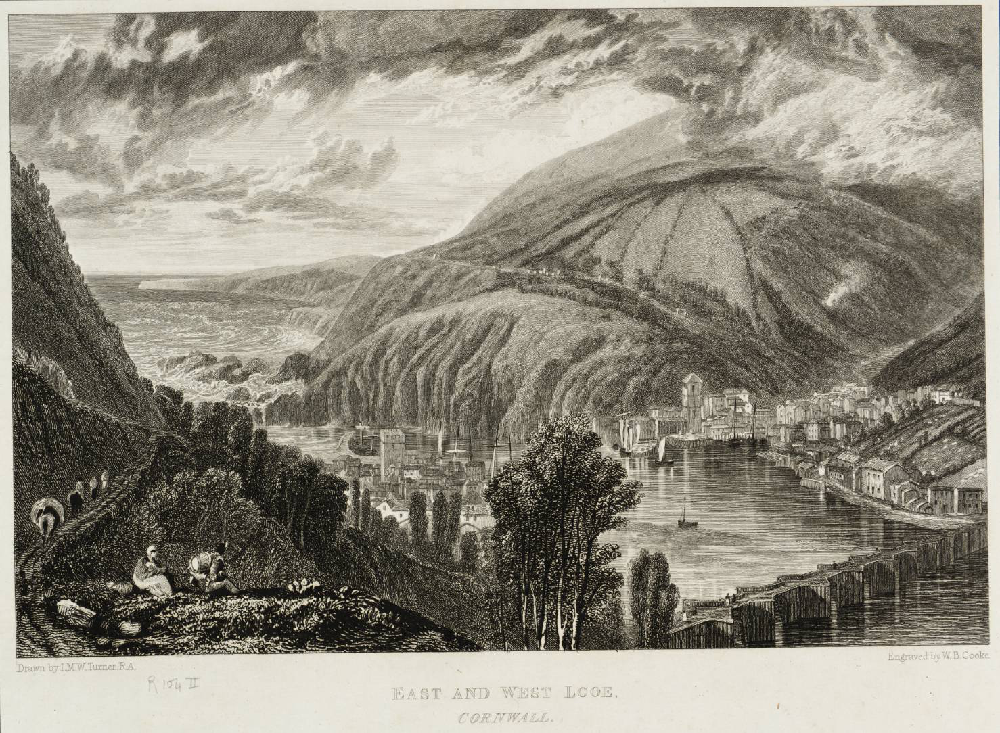

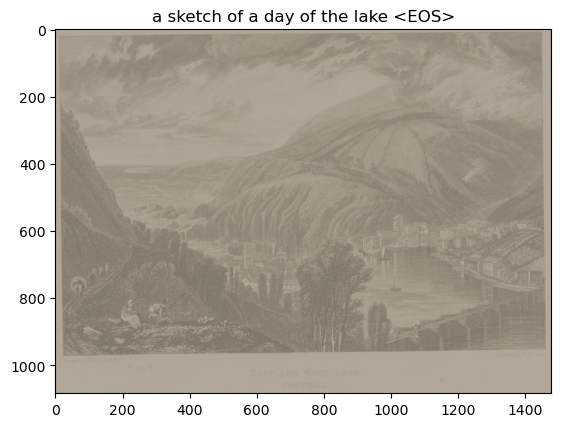

Caption: ['a', 'sketch', 'of', 'a', 'day', 'of', 'the', 'lake', '<EOS>']


In [42]:
show_image_and_captions("https://media.tate.org.uk/art/images/work/T/T05/T05978_10.jpg")

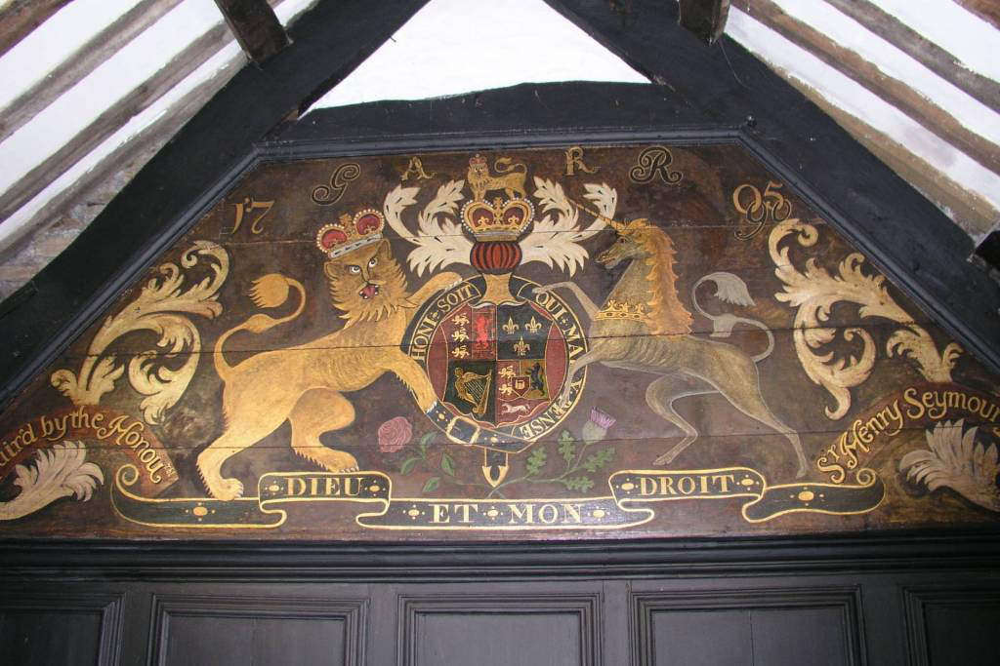

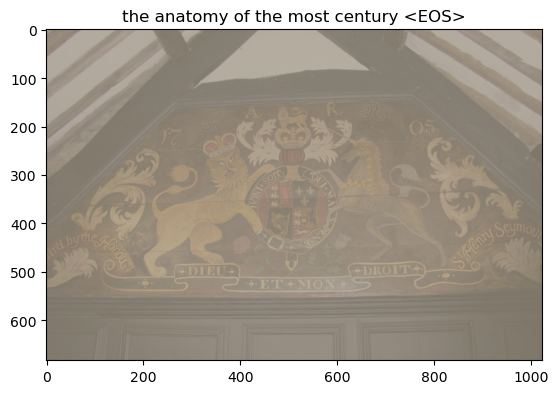

Caption: ['the', 'anatomy', 'of', 'the', 'most', 'century', '<EOS>']


In [43]:
show_image_and_captions("https://welcometolooe.com/wp-content/uploads/2022/02/Coat-of-arms-picture-1024x683.jpg")

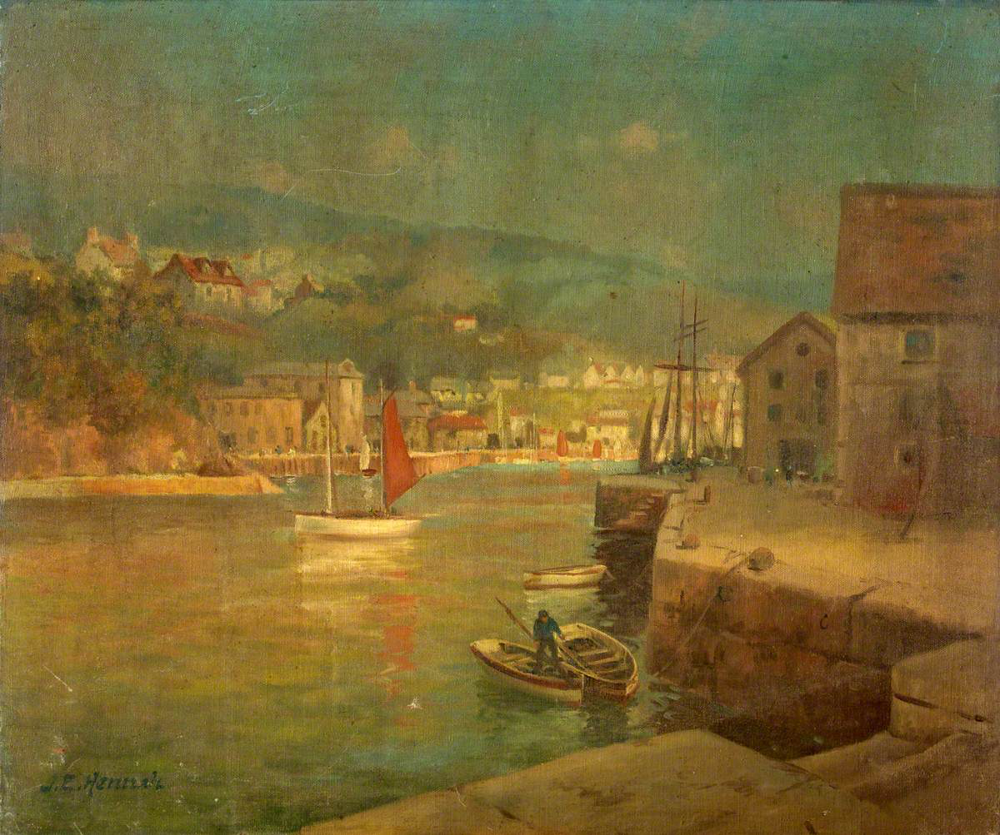

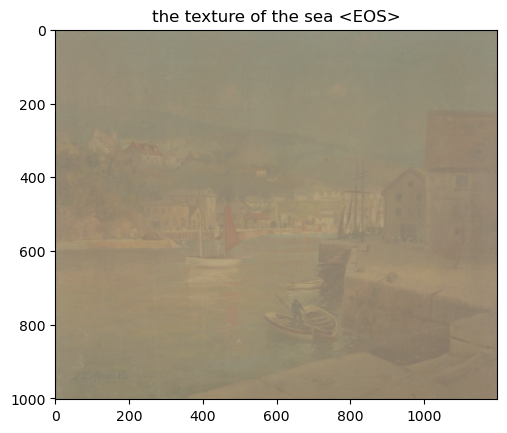

Caption: ['the', 'texture', 'of', 'the', 'sea', '<EOS>']


In [44]:
show_image_and_captions("https://d3d00swyhr67nd.cloudfront.net/w1200h1200/collection/SW/NPMAG/SW_NPMAG_TEMP_2006_1554-001.jpg")

In [28]:
for data in data_loader:
  #print(data)
  example = data
  break

In [33]:
# Switch Device to cpu
device = "cpu"
device
model.to(device)

EncoderDecoder(
  (encoder): EncoderCNN(
    (resnet): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
 

In [31]:
# convert to quantized version
torch.quantization.convert(model, inplace=True)

EncoderDecoder(
  (encoder): EncoderCNN(
    (resnet): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace=True)
 

In [38]:
traced_script_module = torch.jit.trace(model, example)
traced_script_module_optimized = optimize_for_mobile(traced_script_module)
traced_script_module_optimized._save_for_lite_interpreter("image_caption_model.ptl")
traced_script_module_optimized._save_for_lite_interpreter("image_caption_model.ff", _use_flatbuffer=True)

C:\Users\jafru\AppData\Local\Temp\ipykernel_8084\2319324315.py:35: TracerWarning: Using len to get tensor shape might cause the trace to be incorrect. Recommended usage would be tensor.shape[0]. Passing a tensor of different shape might lead to errors or silently give incorrect results.
  seq_length = len(captions[0])-1 #Exclude the last one


In [ ]:
from torch.utils.mobile_optimizer import optimize_for_mobile

# Creating a dummy input
"""test_text = "this is a cat"
text_inputs = processor(text=test_text, return_tensors="pt")
tokenized_text = tokenizer.tokenize(test_text)

url = "http://images.cocodataset.org/val2017/000000039769.jpg"
image = Image.open(requests.get(url, stream=True).raw)
image_inputs = processor(images=image, return_tensors="pt")"""

#example
traced_script_module = torch.jit.trace_module(trained_model, example) 

# Creating the trace

"""traced_script_module = torch.jit.trace(trained_model,  {'vision_model': [image_inputs['pixel_values']],
                                            'text_decoder': [text_inputs['input_ids'], text_inputs['attention_mask']]})"""

traced_script_module_optimized = optimize_for_mobile(traced_script_module)
traced_script_module_optimized._save_for_lite_interpreter("optimised_image_caption_model.ptl")

In [ ]:
class DecisionGate(torch.nn.Module):
    def forward(self, x):
        if x.sum() > 0:
            return x
        else:
            return -x
        
scripted_gate = torch.jit.script(DecisionGate())

trained_model.eval()
trained_model = model(scripted_gate)
scripted_cell = torch.jit.script(trained_model, example)

print(scripted_gate.code)
print(scripted_cell.code)

In [ ]:
#generate caption
def get_caps_from(features_tensors):
    #generate the caption
    model.eval()
    with torch.no_grad():
        features = model.encoder(features_tensors.to(device))
        caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
        caption = ' '.join(caps)
        show_image(features_tensors[0],title=caption)

    return caps,alphas

#Show attention
def plot_attention(img, result, attention_plot):
    #untransform
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224
    img[2] = img[2] * 0.225
    img[0] += 0.485
    img[1] += 0.456
    img[2] += 0.406

    img = img.numpy().transpose((1, 2, 0))
    temp_image = img

    fig = plt.figure(figsize=(15, 15))

    len_result = len(result)
    for l in range(len_result):
        temp_att = attention_plot[l].reshape(7,7)

        ax = fig.add_subplot(len_result//2,len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.7, extent=img.get_extent())


    plt.tight_layout()
    plt.show()